In [1]:
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from __future__ import print_function
import keras
from keras.preprocessing.image import ImageDataGenerator, load_img

Using TensorFlow backend.


In [2]:
train_dir = './ford_clf/train'
validation_dir = './ford_clf/test/'
image_size = 224

In [5]:
from keras.applications import VGG16

#Load the VGG model
vgg_conv = VGG16(weights='imagenet', include_top=False, input_shape=(image_size, image_size, 3))

# Freeze all the layers
for layer in vgg_conv.layers[:-4]:
    layer.trainable = False

# Check the trainable status of the individual layers
for layer in vgg_conv.layers:
    print(layer, layer.trainable)


from keras import models
from keras import layers
from keras import optimizers

# Create the model
model = models.Sequential()

# Add the vgg convolutional base model
model.add(vgg_conv)

# Add new layers
model.add(layers.Flatten())
model.add(layers.Dense(1024, activation='relu'))
model.add(layers.Dropout(0.5))
model.add(layers.Dense(17, activation='softmax'))

# Show a summary of the model. Check the number of trainable parameters
model.summary()

<keras.engine.topology.InputLayer object at 0x7f3f8067afd0> False
<keras.layers.convolutional.Conv2D object at 0x7f3f806342e8> False
<keras.layers.convolutional.Conv2D object at 0x7f3f806340f0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3f80634c50> False
<keras.layers.convolutional.Conv2D object at 0x7f3f806449b0> False
<keras.layers.convolutional.Conv2D object at 0x7f3f8065c7f0> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3f8121beb8> False
<keras.layers.convolutional.Conv2D object at 0x7f3f8122fe80> False
<keras.layers.convolutional.Conv2D object at 0x7f3f812422e8> False
<keras.layers.convolutional.Conv2D object at 0x7f3f811d4ac8> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3f811f7fd0> False
<keras.layers.convolutional.Conv2D object at 0x7f3f811a4080> False
<keras.layers.convolutional.Conv2D object at 0x7f3f811a4390> False
<keras.layers.convolutional.Conv2D object at 0x7f3f811b6f28> False
<keras.layers.pooling.MaxPooling2D object at 0x7f3f8115bfd0> Fa

Found 5326 images belonging to 17 classes.
Found 1235 images belonging to 17 classes.
Epoch 1/20


/home/ubuntu/anaconda3/lib/python3.6/site-packages/PIL/Image.py:888: UserWarning: Palette images with Transparency   expressed in bytes should be converted to RGBA images
  'to RGBA images')


 20/106 [====>.........................] - ETA: 5:02 - loss: 2.9792 - acc: 0.0770

/home/ubuntu/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:709: UserWarning: Corrupt EXIF data.  Expecting to read 4 bytes but only got 0. 
  warnings.warn(str(msg))


106/106 [============================>.] - ETA: 1s - loss: 2.7735 - acc: 0.1170

/home/ubuntu/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 8 bytes but only got 4. Skipping tag 41730
  " Skipping tag %s" % (size, len(data), tag))
/home/ubuntu/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 8 bytes but only got 0. Skipping tag 41988
  " Skipping tag %s" % (size, len(data), tag))


107/106 [==============================] - 404s 4s/step - loss: 2.7702 - acc: 0.1175 - val_loss: 2.3600 - val_acc: 0.2405
Epoch 2/20
107/106 [==============================] - 389s 4s/step - loss: 2.3371 - acc: 0.2573 - val_loss: 1.7497 - val_acc: 0.4332
Epoch 3/20
107/106 [==============================] - 388s 4s/step - loss: 1.8206 - acc: 0.4297 - val_loss: 1.5676 - val_acc: 0.4980
Epoch 4/20
107/106 [==============================] - 387s 4s/step - loss: 1.4182 - acc: 0.5577 - val_loss: 1.5337 - val_acc: 0.5239
Epoch 5/20
107/106 [==============================] - 382s 4s/step - loss: 1.1532 - acc: 0.6382 - val_loss: 1.0820 - val_acc: 0.6777
Epoch 6/20
107/106 [==============================] - 384s 4s/step - loss: 0.8996 - acc: 0.7217 - val_loss: 0.8566 - val_acc: 0.7336
Epoch 7/20
107/106 [==============================] - 383s 4s/step - loss: 0.7488 - acc: 0.7687 - val_loss: 0.8909 - val_acc: 0.7530
Epoch 8/20
107/106 [==============================] - 381s 4s/step - loss: 0.605

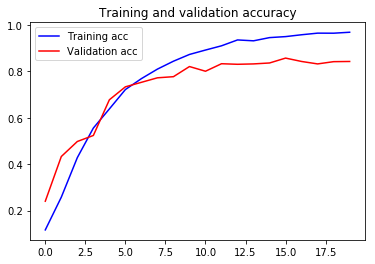

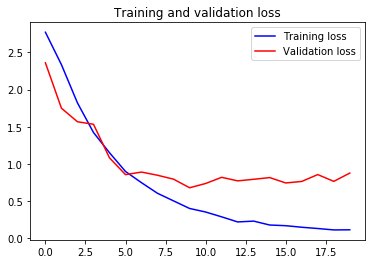

In [6]:
train_datagen = ImageDataGenerator(
      rescale=1./255,
      rotation_range=20,
      width_shift_range=0.2,
      height_shift_range=0.2,
      horizontal_flip=True,
      fill_mode='nearest')

validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10

# Data Generator for Training data
train_generator = train_datagen.flow_from_directory(
        train_dir,
        target_size=(image_size, image_size),
        batch_size=train_batchsize,
        class_mode='categorical')

# Data Generator for Validation data
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Compile the model
model.compile(loss='categorical_crossentropy',
              optimizer=optimizers.RMSprop(lr=1e-4),
              metrics=['acc'])

# Train the Model
# NOTE that we have multiplied the steps_per_epoch by 2. This is because we are using data augmentation.
history = model.fit_generator(
      train_generator,
      steps_per_epoch=2*train_generator.samples/train_generator.batch_size ,
      epochs=20,
      validation_data=validation_generator,
      validation_steps=validation_generator.samples/validation_generator.batch_size,
      verbose=1)

# Save the Model
model.save('ford_test.h5')

# Plot the accuracy and loss curves
acc = history.history['acc']
val_acc = history.history['val_acc']
loss = history.history['loss']
val_loss = history.history['val_loss']

epochs = range(len(acc))

plt.plot(epochs, acc, 'b', label='Training acc')
plt.plot(epochs, val_acc, 'r', label='Validation acc')
plt.title('Training and validation accuracy')
plt.legend()

plt.figure()

plt.plot(epochs, loss, 'b', label='Training loss')
plt.plot(epochs, val_loss, 'r', label='Validation loss')
plt.title('Training and validation loss')
plt.legend()

plt.show()

Found 1235 images belonging to 17 classes.
 67/123 [===============>..............] - ETA: 13s

/home/ubuntu/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 8 bytes but only got 4. Skipping tag 41730
  " Skipping tag %s" % (size, len(data), tag))
/home/ubuntu/anaconda3/lib/python3.6/site-packages/PIL/TiffImagePlugin.py:692: UserWarning: Possibly corrupt EXIF data.  Expecting to read 8 bytes but only got 0. Skipping tag 41988
  " Skipping tag %s" % (size, len(data), tag))


124/123 [==============================] - 29s 236ms/step
No of errors = 194/1235
350z/350z_137.jpg


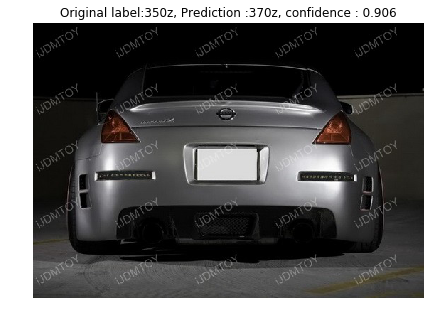

350z/350z_157.jpg


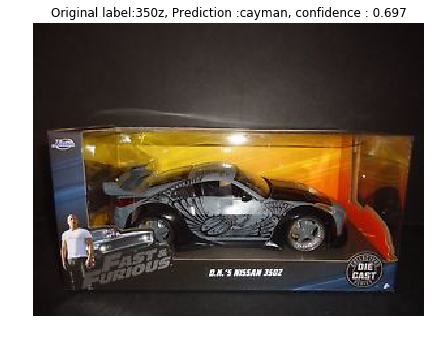

350z/350z_337.jpg


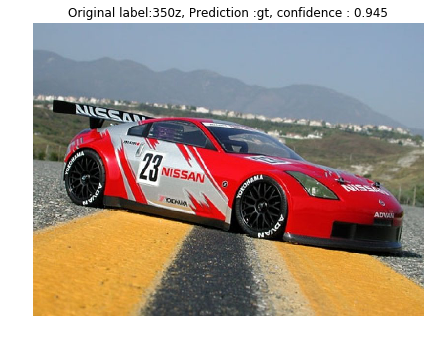

350z/350z_355.jpg


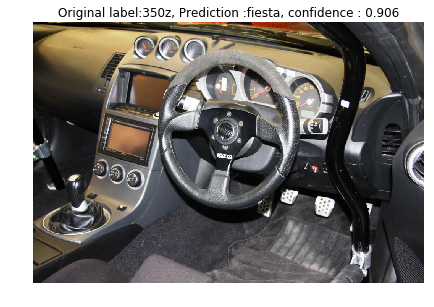

350z/350z_415.jpg


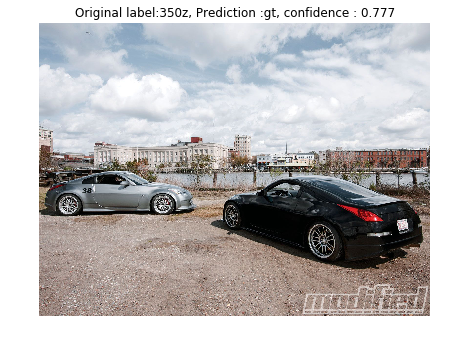

370z/370z_370z_117.jpg


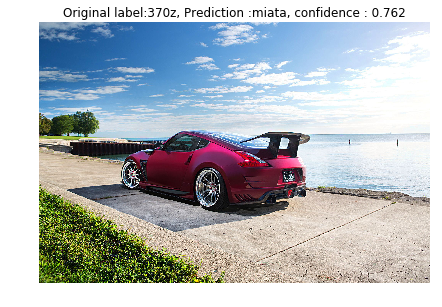

370z/370z_370z_145.jpg


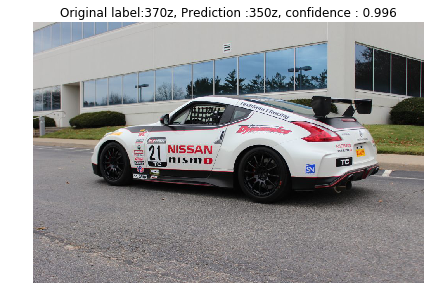

370z/370z_370z_185.jpg


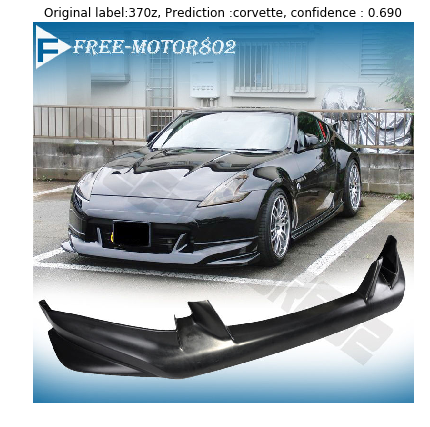

370z/370z_370z_187.jpg


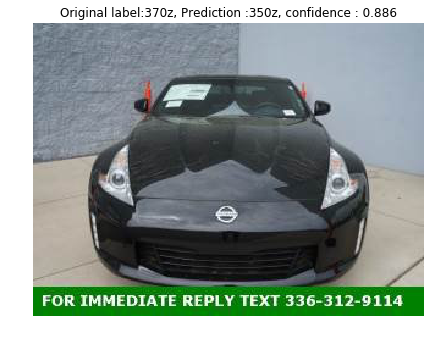

370z/370z_370z_207.jpg


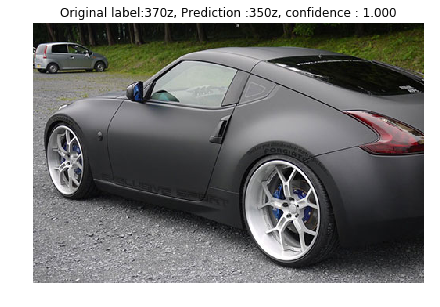

370z/370z_370z_25.jpg


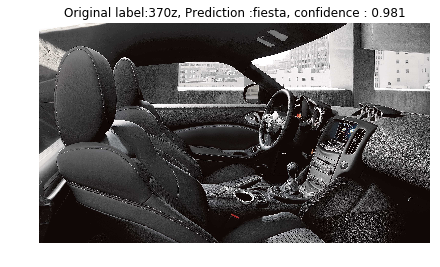

370z/370z_370z_295.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


370z/370z_370z_435.jpg


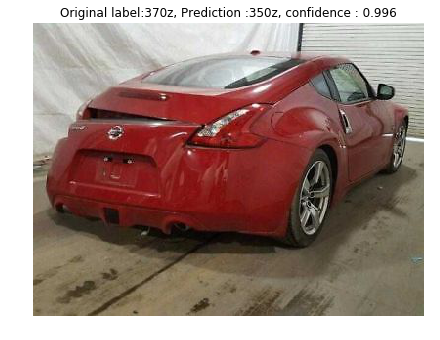

370z/370z_370z_445.jpg


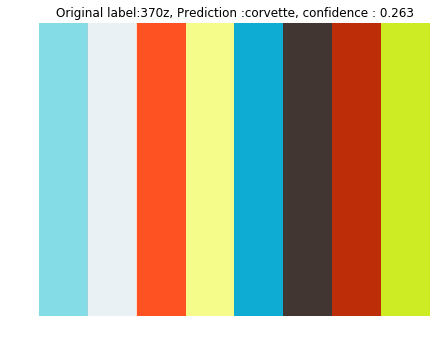

370z/370z_370z_67.jpg


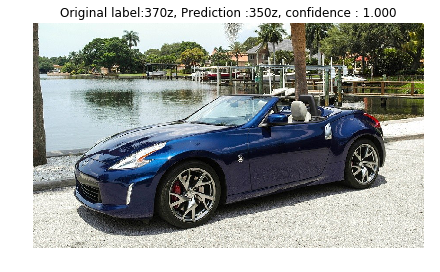

370z/370z_370z_7.jpg


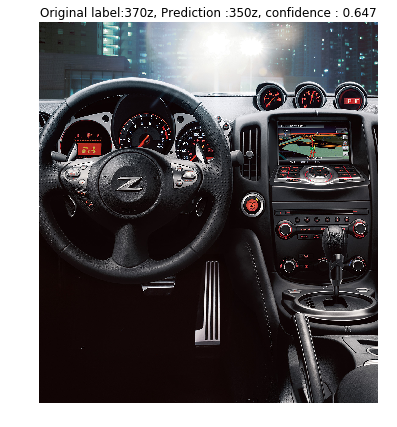

370z/370z_370z_75.jpg


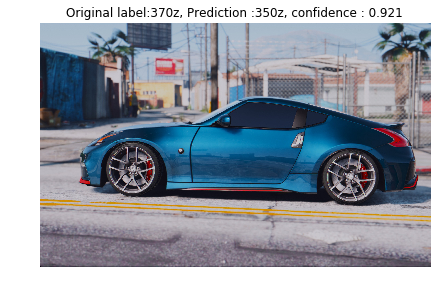

911/911_145.jpg


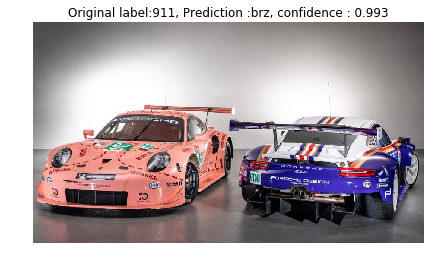

911/911_155.jpg


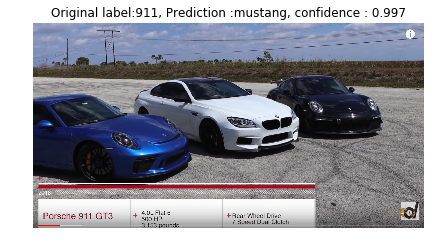

911/911_165.jpg


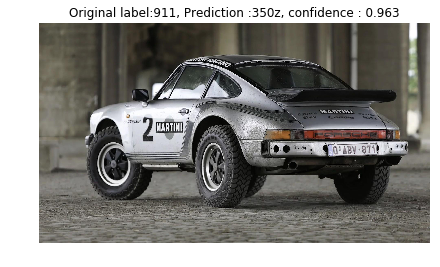

911/911_247.jpg


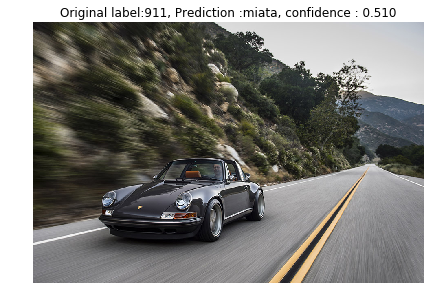

911/911_355.jpg


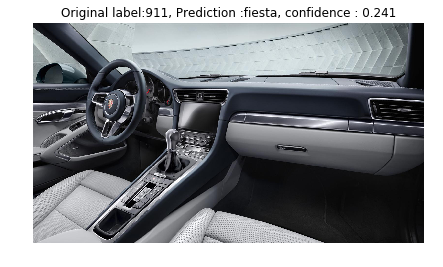

911/911_37.jpg


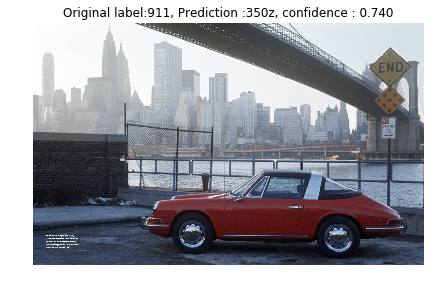

911/911_427.jpg


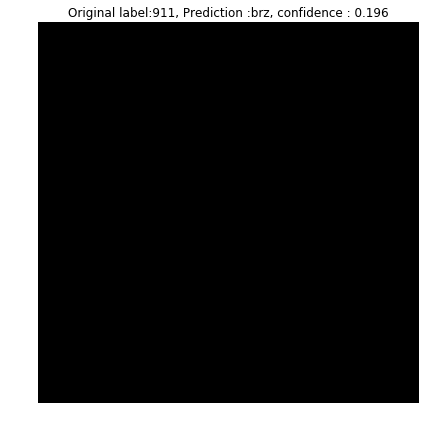

911/911_45.jpg


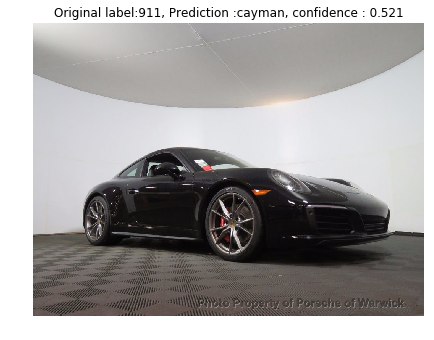

911/911_87.jpg


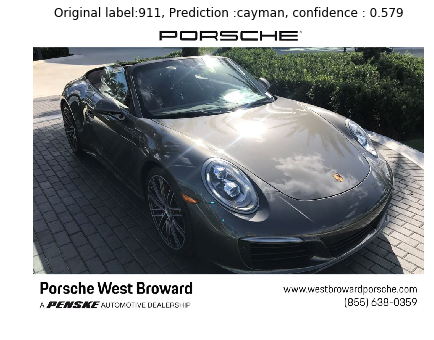

911/911_97.jpg


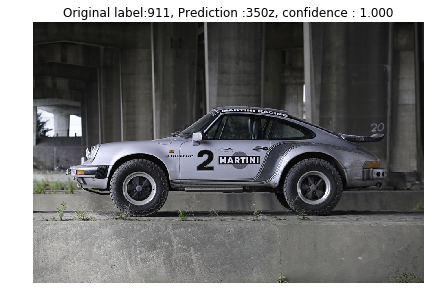

brz/brz_brz_117.jpg


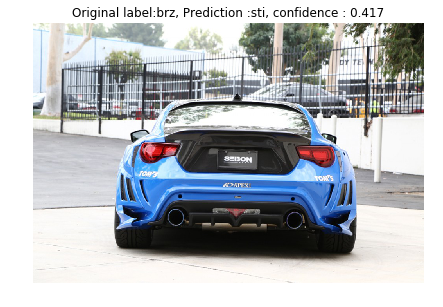

brz/brz_brz_145.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


brz/brz_brz_235.jpg


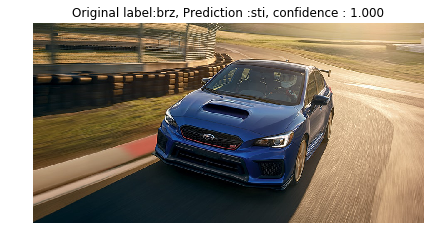

brz/brz_brz_267.jpg


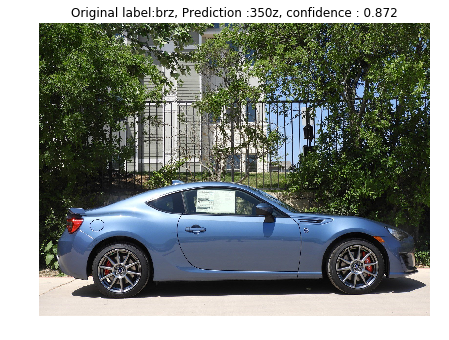

brz/brz_brz_337.jpg


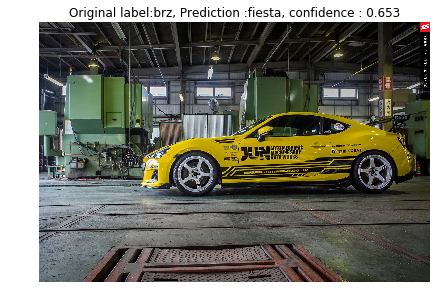

brz/brz_brz_347.jpg


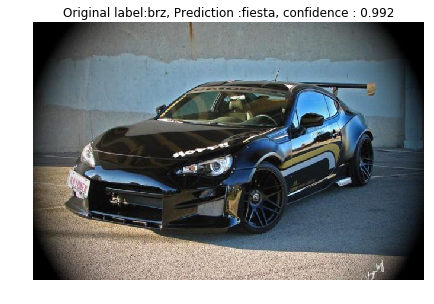

brz/brz_brz_35.jpg


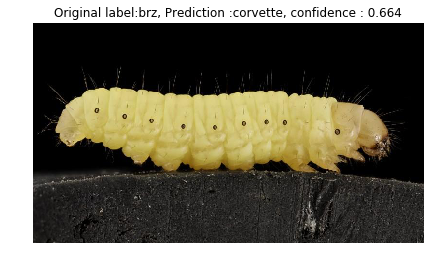

brz/brz_brz_367.jpg


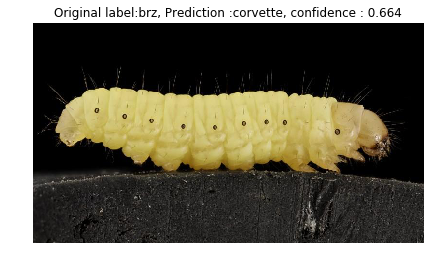

brz/brz_brz_387.jpg


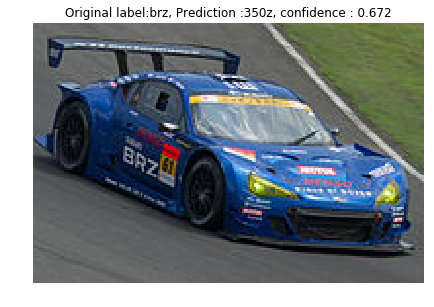

brz/brz_brz_435.jpg


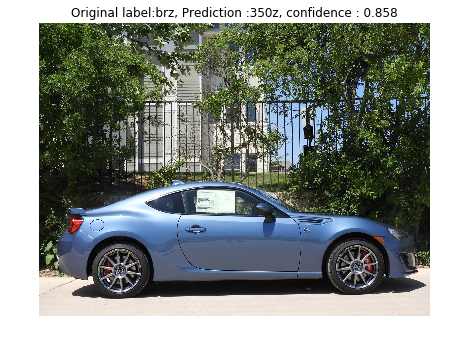

camaro/camaro_107.jpg


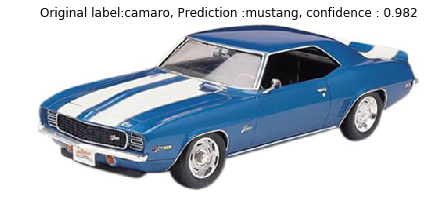

camaro/camaro_117.jpg


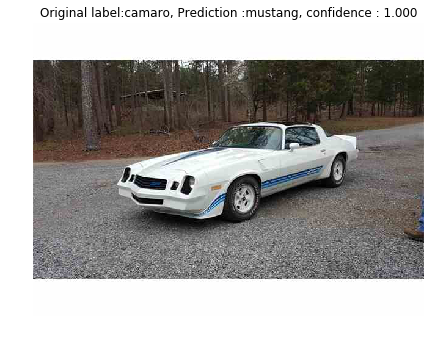

camaro/camaro_125.jpg


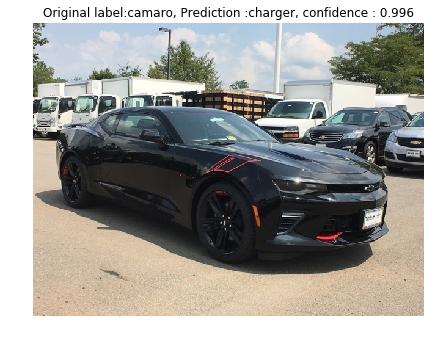

camaro/camaro_135.jpg


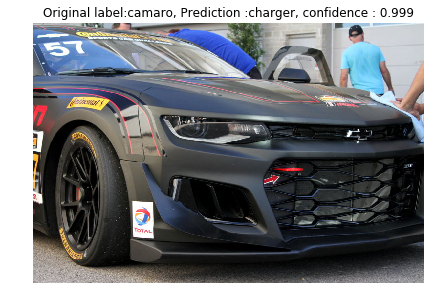

camaro/camaro_137.jpg


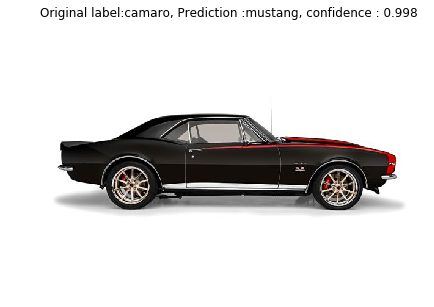

camaro/camaro_145.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


camaro/camaro_217.jpg


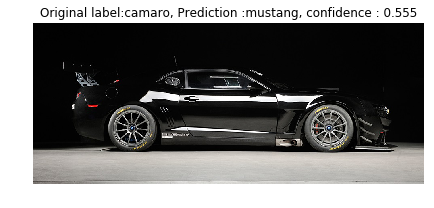

camaro/camaro_25.jpg


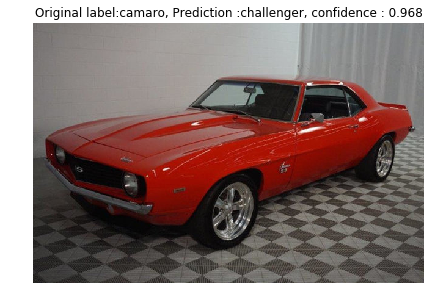

camaro/camaro_27.jpg


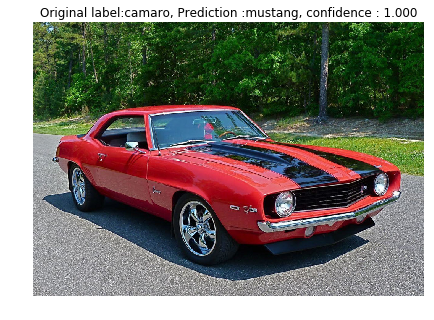

camaro/camaro_315.jpg


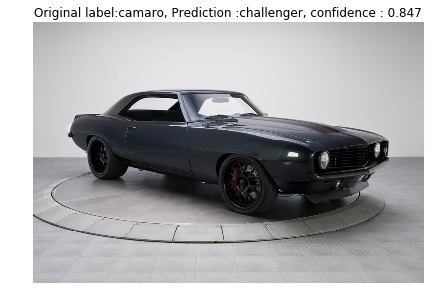

camaro/camaro_345.jpg


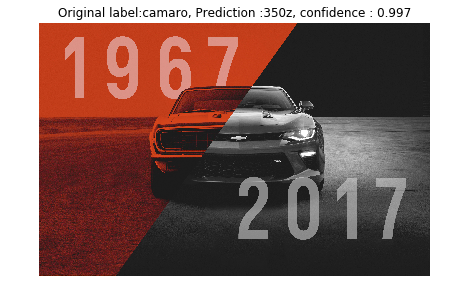

camaro/camaro_35.jpg


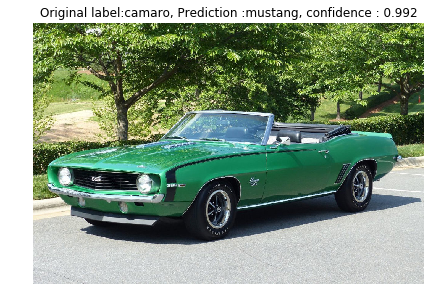

camaro/camaro_355.jpg


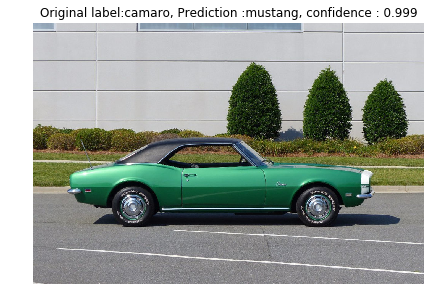

camaro/camaro_357.jpg


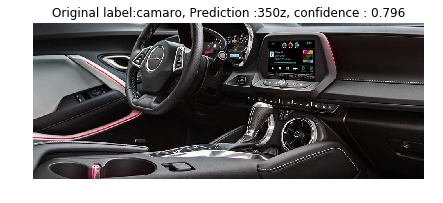

camaro/camaro_407.jpg


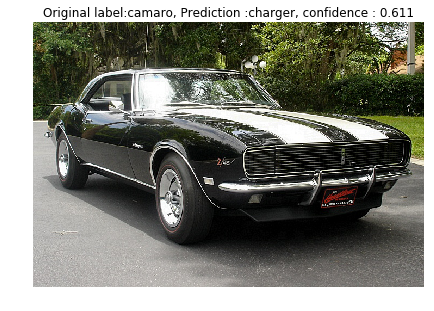

camaro/camaro_445.jpg


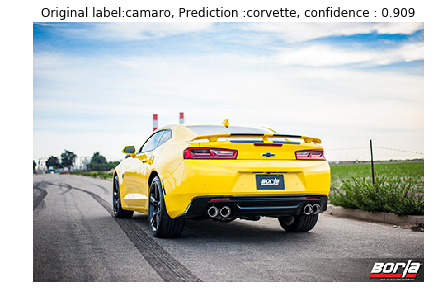

cayman/cayman-105.jpg


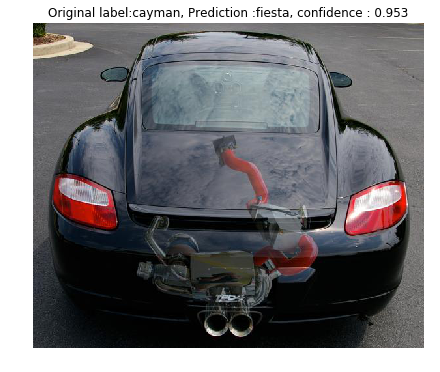

cayman/cayman-187.jpg


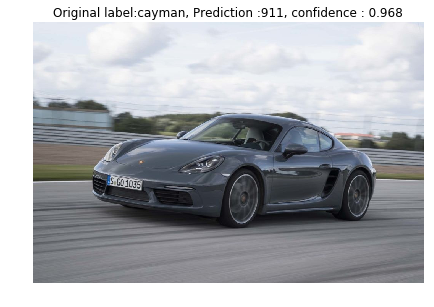

cayman/cayman-245.jpg


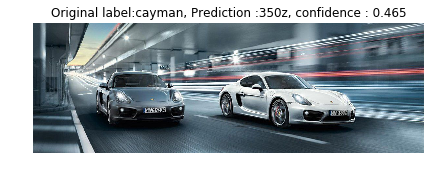

cayman/cayman-257.jpg


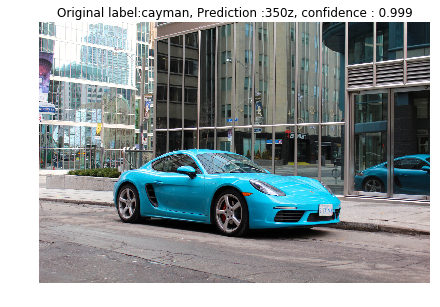

cayman/cayman-55.jpg


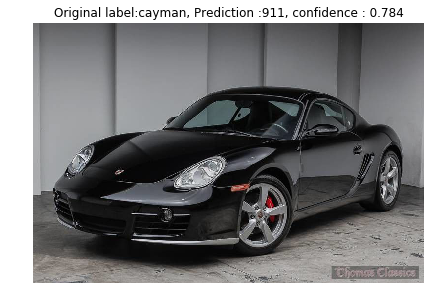

cayman/cayman-75.jpg


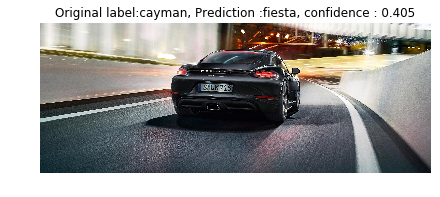

challenger/challenger_105.jpg


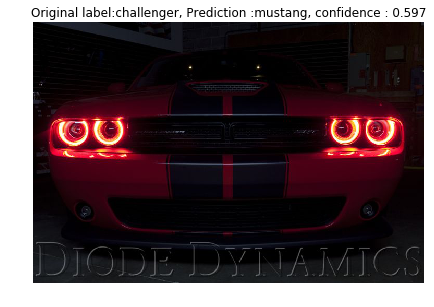

challenger/challenger_107.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


challenger/challenger_247.jpg


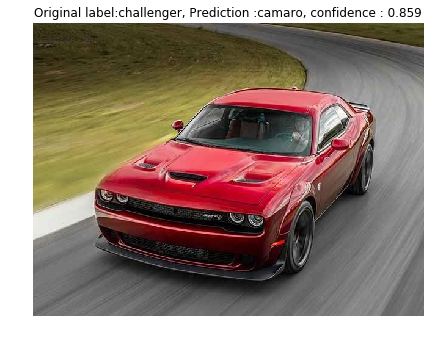

challenger/challenger_317.jpg


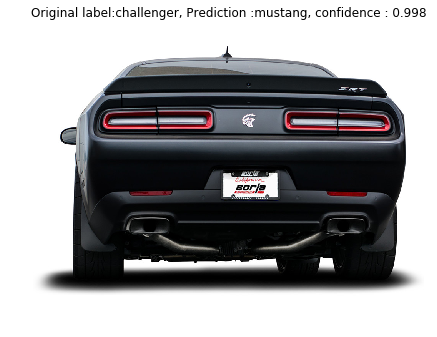

challenger/challenger_35.jpg


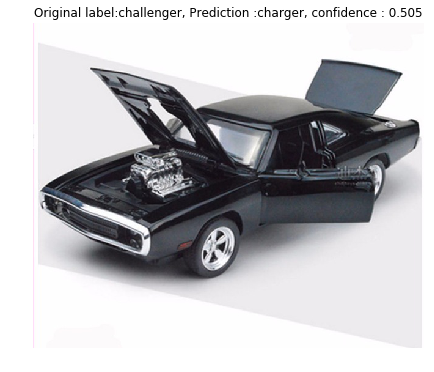

challenger/challenger_87.jpg


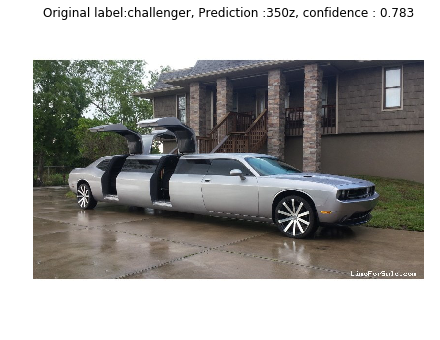

charger/charger_145.jpg


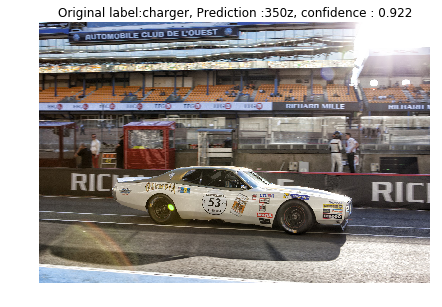

charger/charger_147.jpg


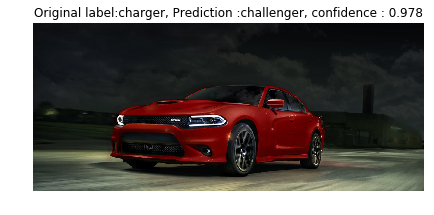

charger/charger_155.jpg


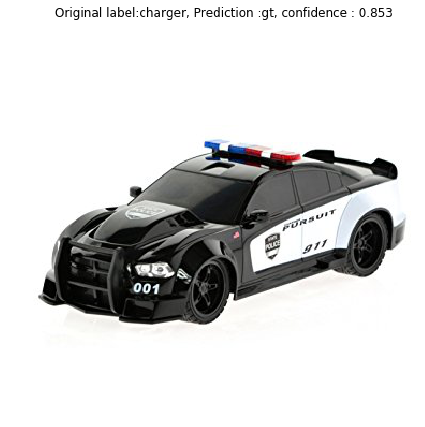

charger/charger_157.jpg


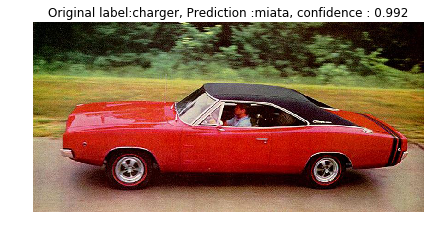

charger/charger_165.jpg


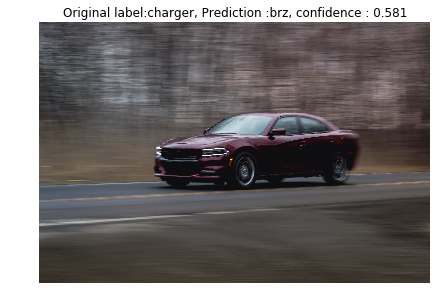

charger/charger_185.jpg


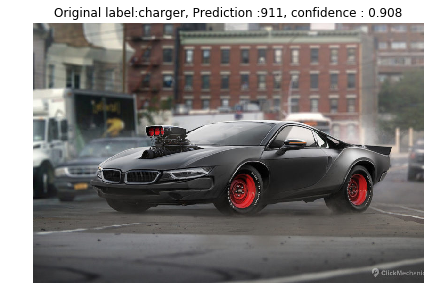

charger/charger_195.jpg


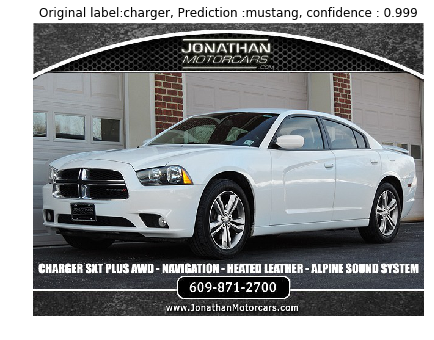

charger/charger_227.jpg


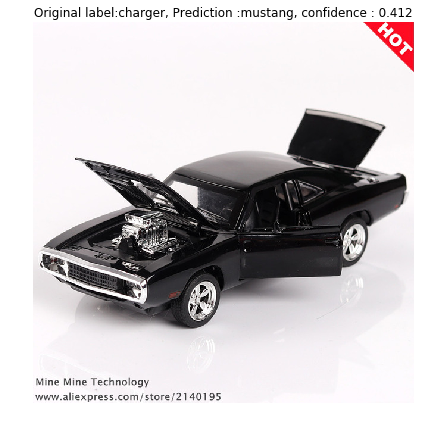

charger/charger_235.jpg


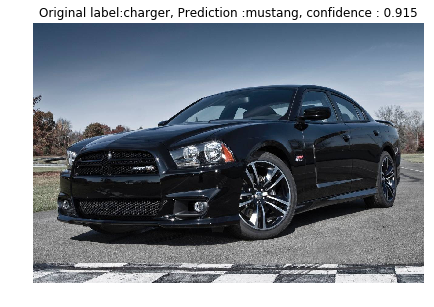

charger/charger_57.jpg


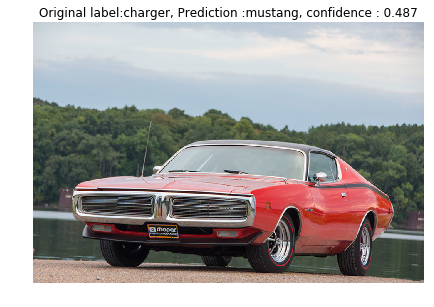

charger/charger_67.jpg


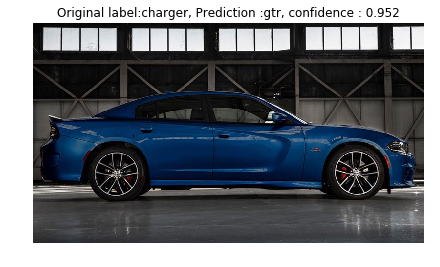

charger/charger_85.jpg


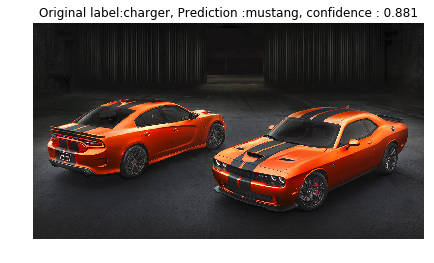

corvette/corvette_105.jpg


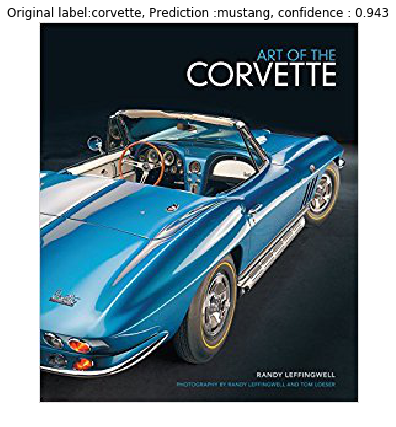

corvette/corvette_145.jpg


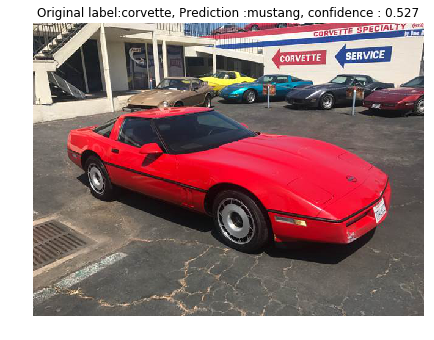

corvette/corvette_165.jpg


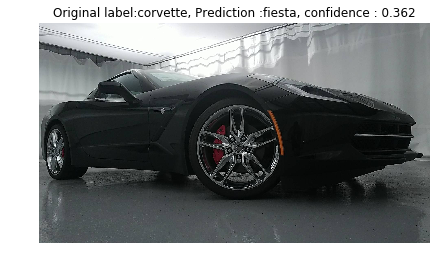

corvette/corvette_167.jpg


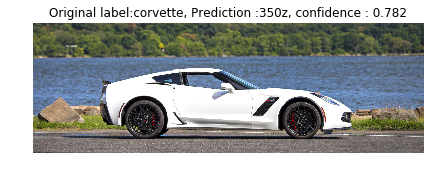

corvette/corvette_187.jpg


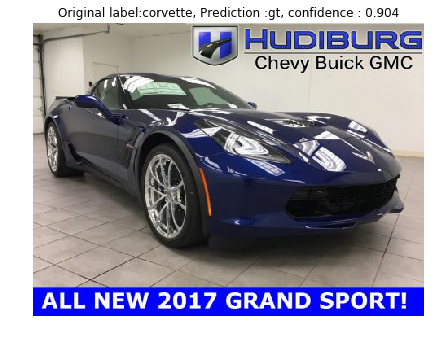

corvette/corvette_265.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


corvette/corvette_65.jpg


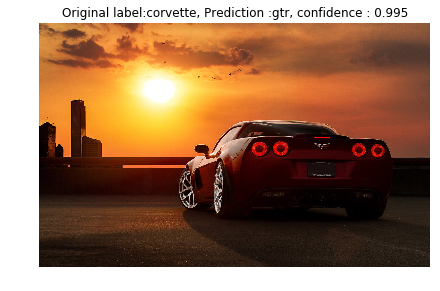

corvette/corvette_87.jpg


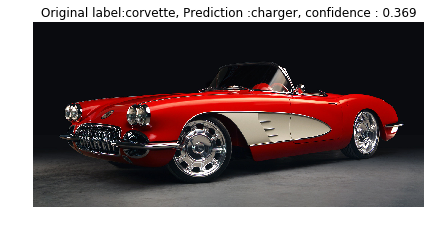

fiesta/fiesta_st_155.jpg


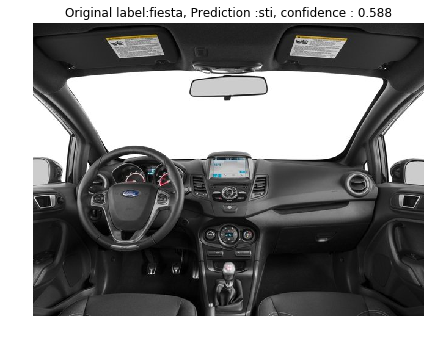

fiesta/fiesta_st_67.jpg


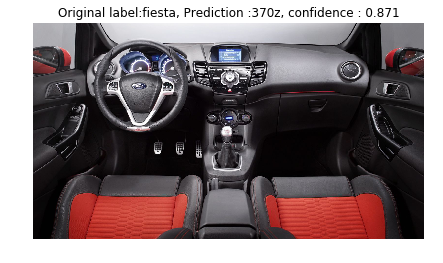

focus/focus_rs_105.jpg


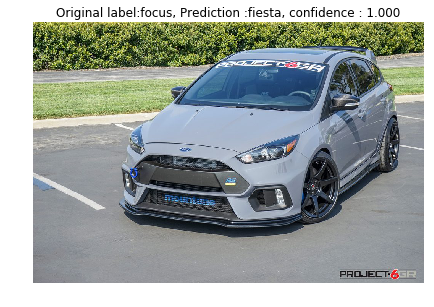

focus/focus_rs_107.jpg


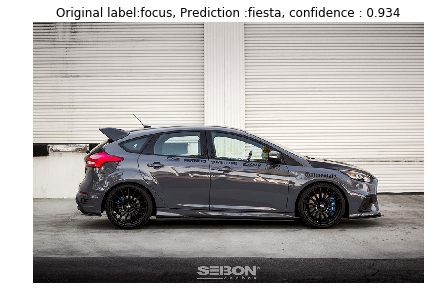

focus/focus_rs_145.jpg


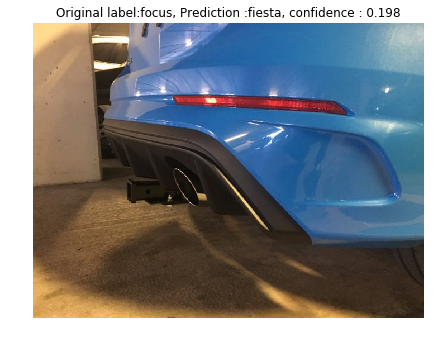

focus/focus_rs_147.jpg


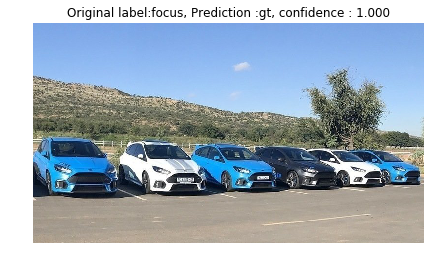

focus/focus_rs_157.jpg


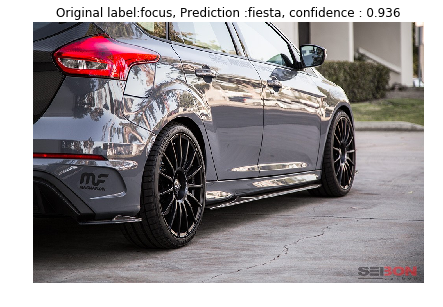

focus/focus_rs_167.jpg


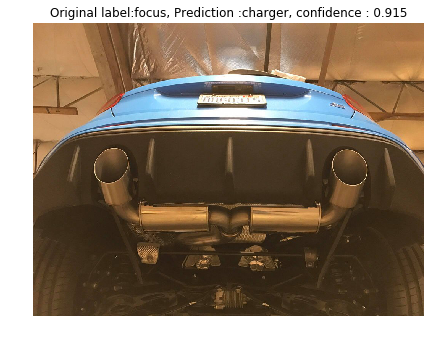

focus/focus_rs_185.jpg


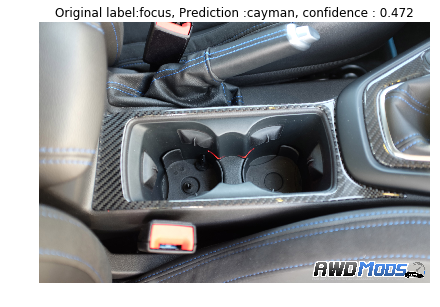

focus/focus_rs_187.jpg


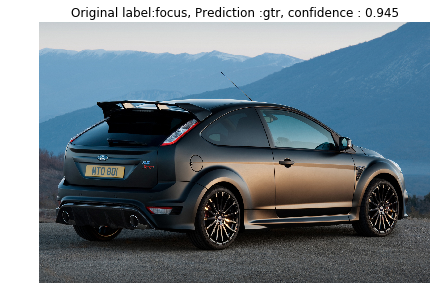

focus/focus_rs_217.jpg


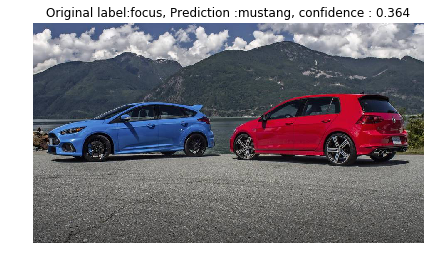

focus/focus_rs_225.jpg


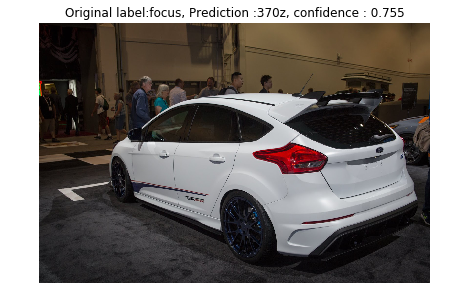

focus/focus_rs_25.jpg


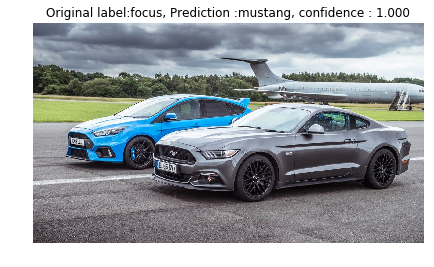

focus/focus_rs_265.jpg


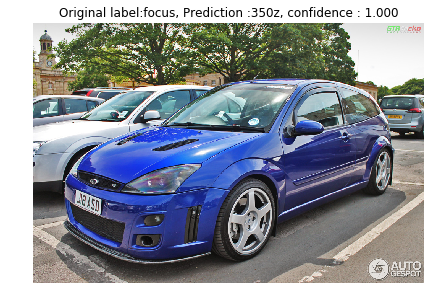

focus/focus_rs_47.jpg


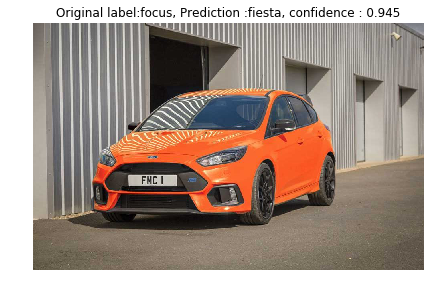

focus/focus_rs_5.jpg


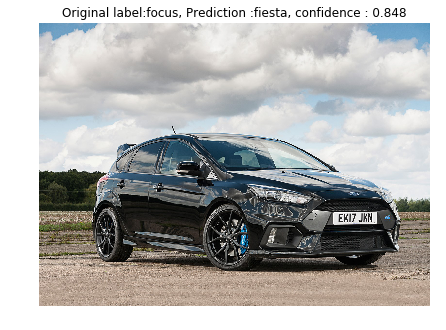

focus/focus_rs_87.jpg


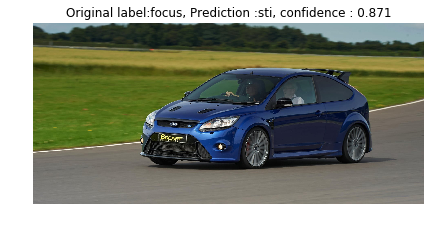

gt/gt_217.jpg


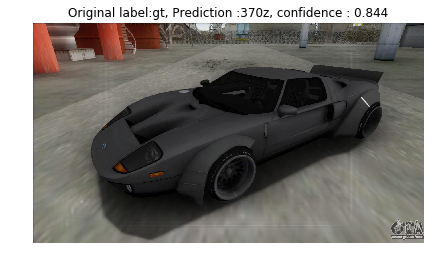

gt/gt_255.jpg


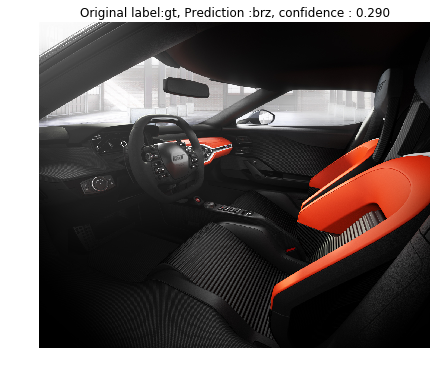

gt/gt_257.jpg


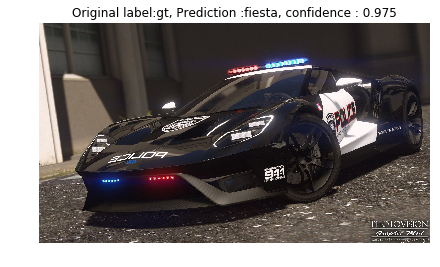

gt/gt_267.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


gtr/gtr_105.jpg


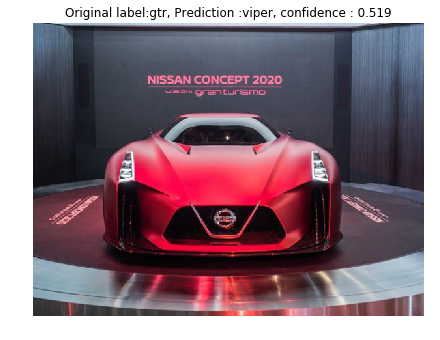

gtr/gtr_147.jpg


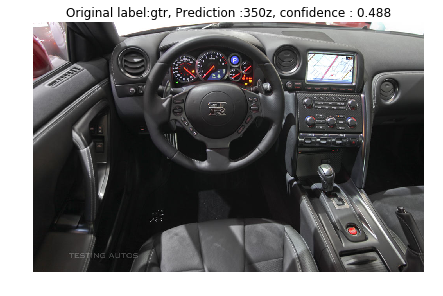

gtr/gtr_157.jpg


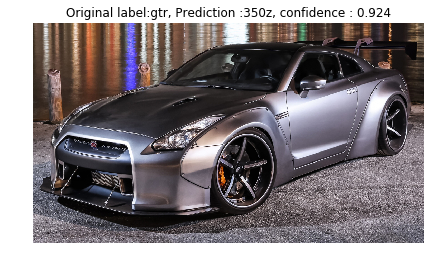

gtr/gtr_175.jpg


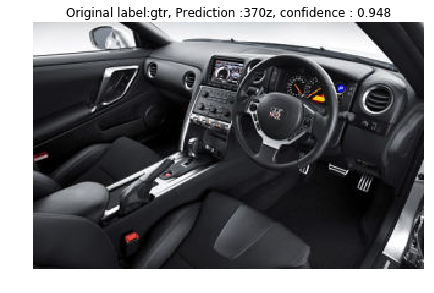

gtr/gtr_265.jpg


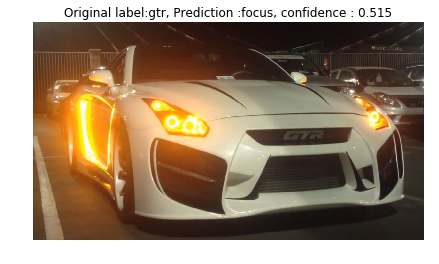

gtr/gtr_297.jpg


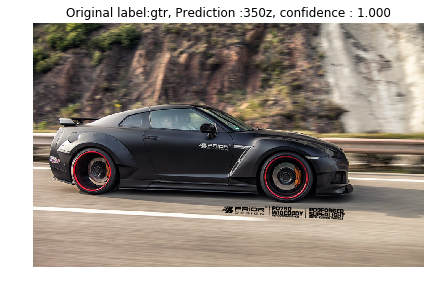

gtr/gtr_345.jpg


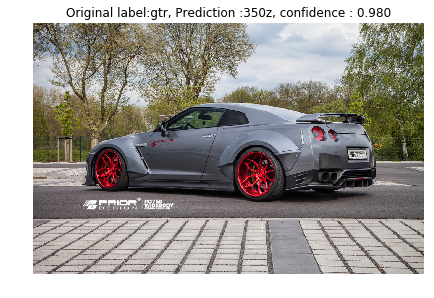

gtr/gtr_355.jpg


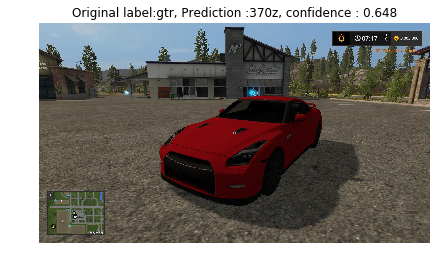

gtr/gtr_85.jpg


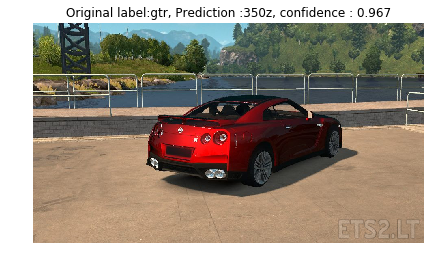

gtr/gtr_97.jpg


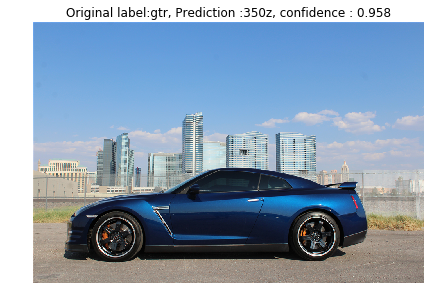

miata/mia_107.jpg


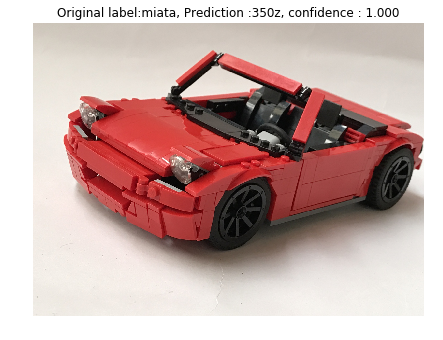

miata/mia_197.jpg


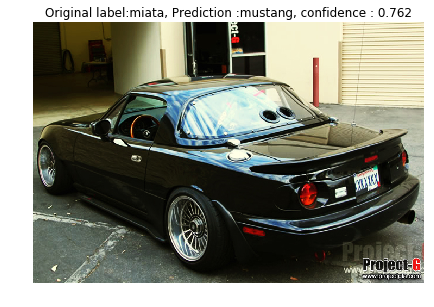

miata/mia_207.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


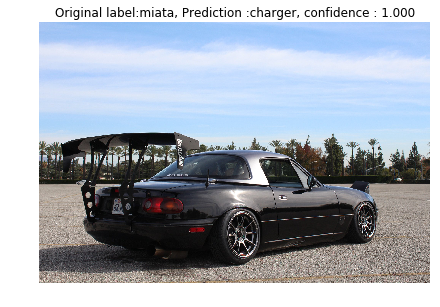

miata/mia_415.jpg


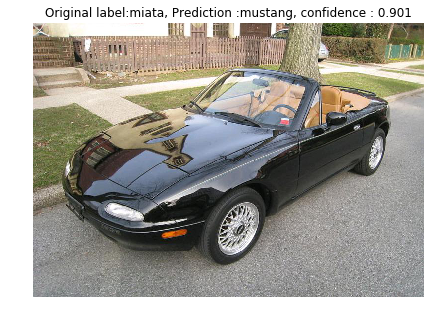

miata/mia_417.jpg


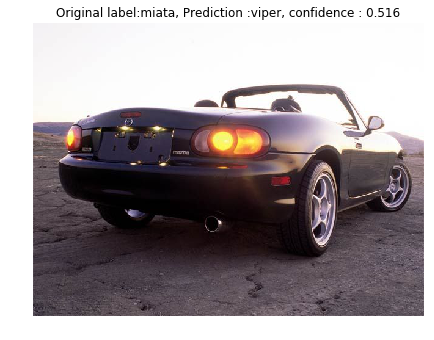

miata/mia_47.jpg


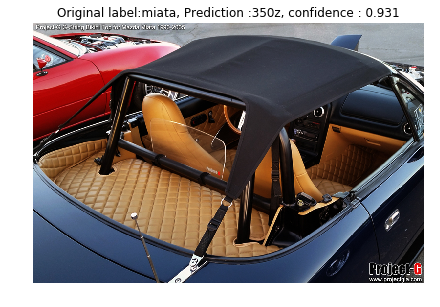

miata/mia_77.jpg


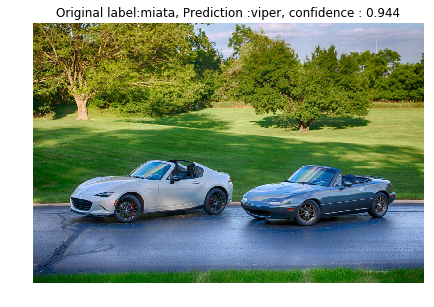

miata/mia_85.jpg


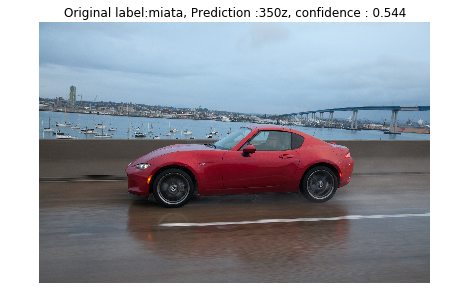

miata/mx_155.jpg


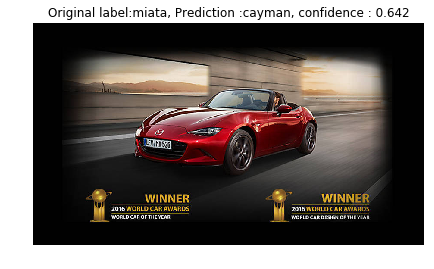

miata/mx_175.jpg


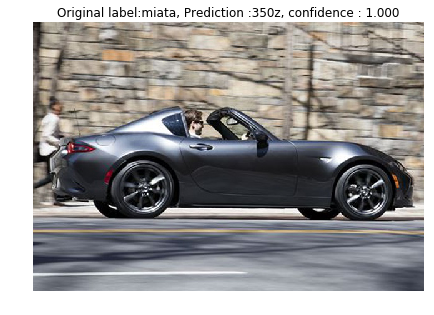

miata/mx_327.jpg


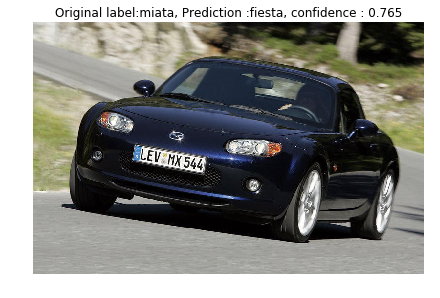

miata/mx_335.jpg


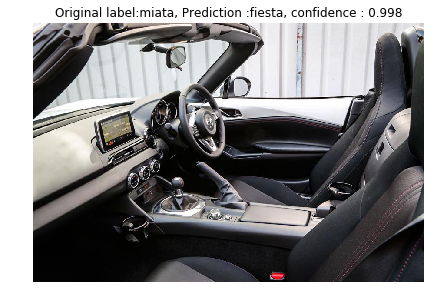

miata/mx_337.jpg


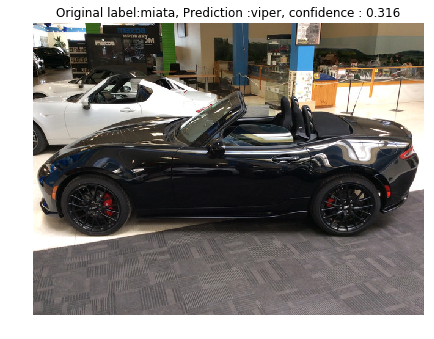

miata/mx_445.jpg


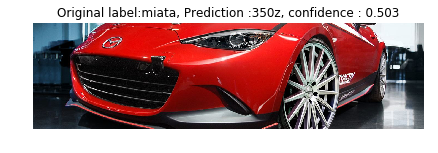

miata/mx_447.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


mustang/mustang_275.jpg


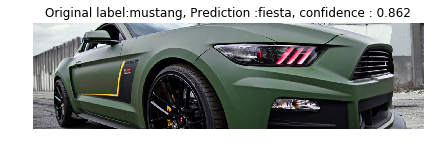

mustang/mustang_285.jpg


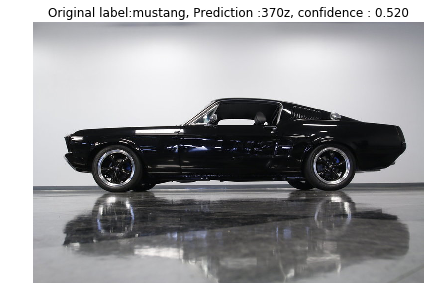

mustang/mustang_305.jpg


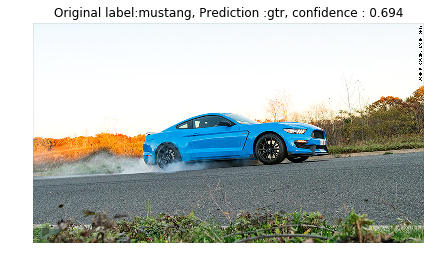

mustang/mustang_327.jpg


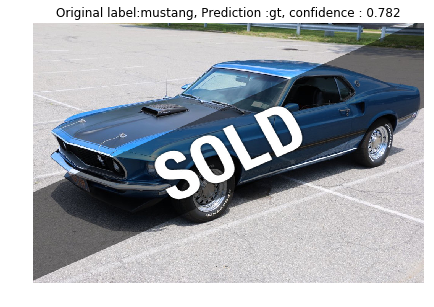

mustang/mustang_387.jpg


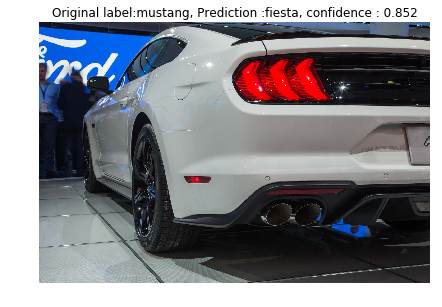

mustang/mustang_455.jpg


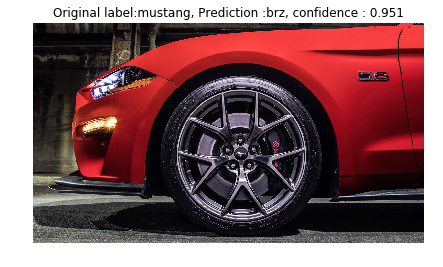

mustang/mustang_507.jpg


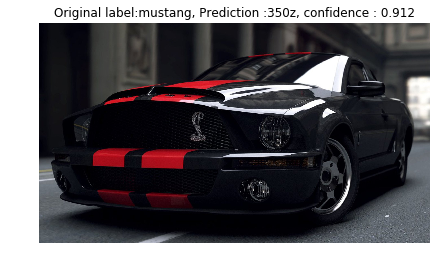

mustang/mustang_517.jpg


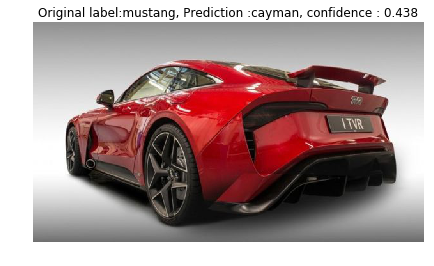

mustang/mustang_55.jpg


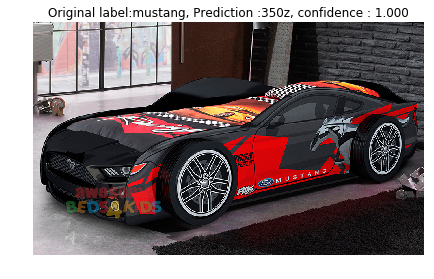

mustang/mustang_555.jpg


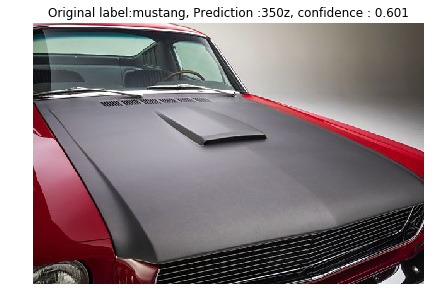

mustang/mustang_715.jpg


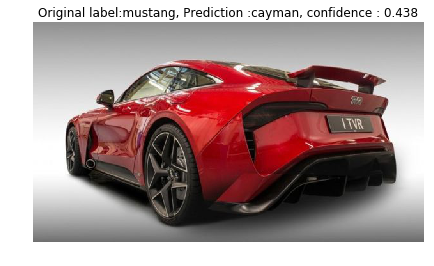

sti/sti_117.jpg


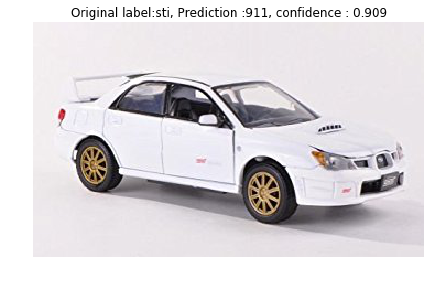

sti/sti_177.jpg


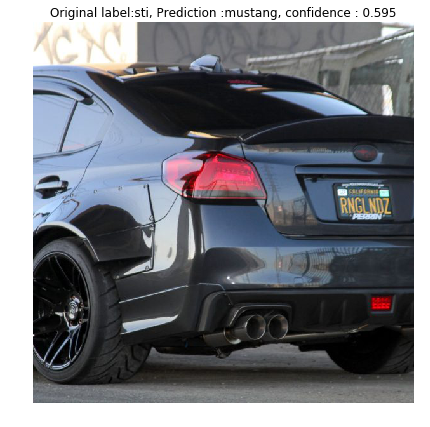

sti/sti_215.jpg


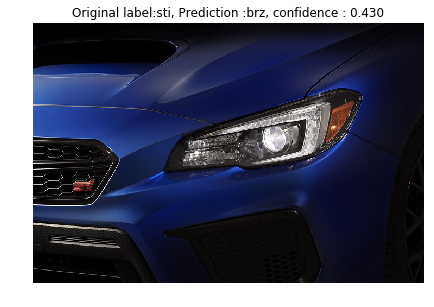

sti/sti_265.jpg


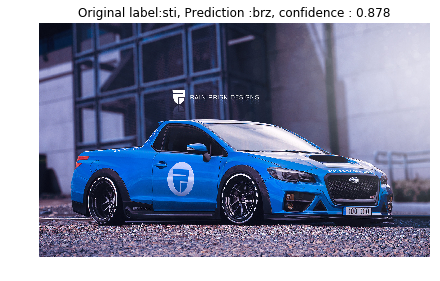

sti/sti_275.jpg


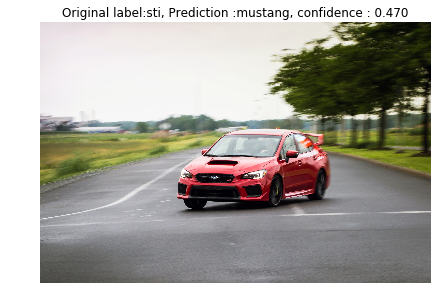

sti/sti_305.jpg


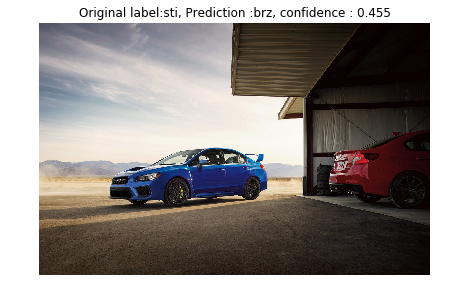

sti/sti_415.jpg


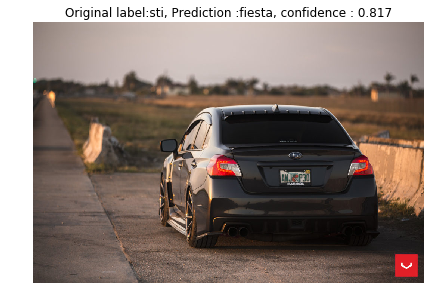

sti/sti_435.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


sti/sti_67.jpg


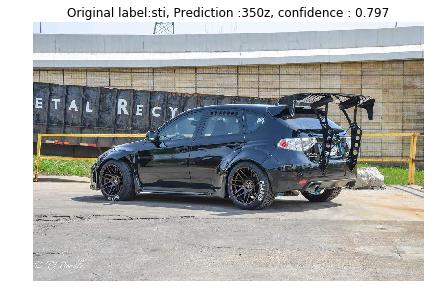

sti/sti_75.jpg


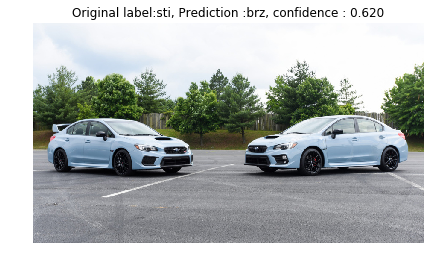

viper/viper_145.jpg


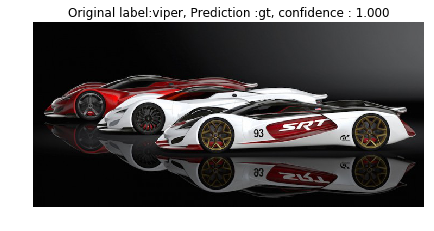

viper/viper_185.jpg


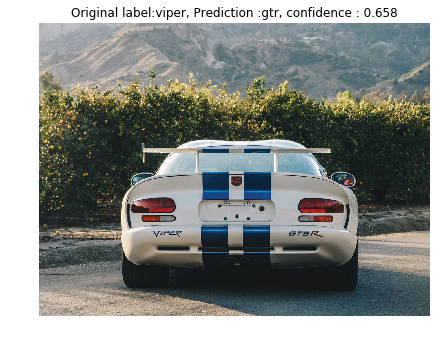

viper/viper_187.jpg


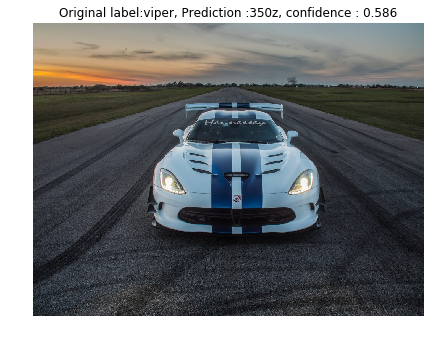

viper/viper_195.jpg


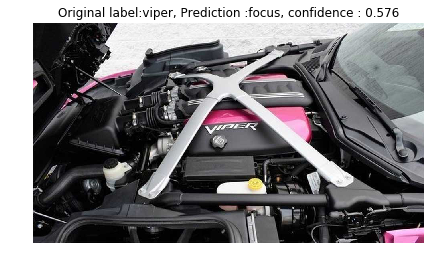

viper/viper_197.jpg


IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.


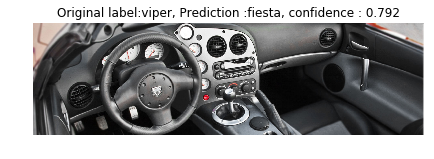

viper/viper_307.jpg


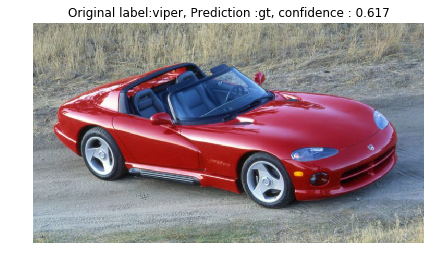

viper/viper_325.jpg


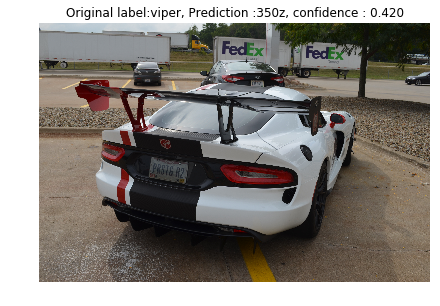

viper/viper_407.jpg


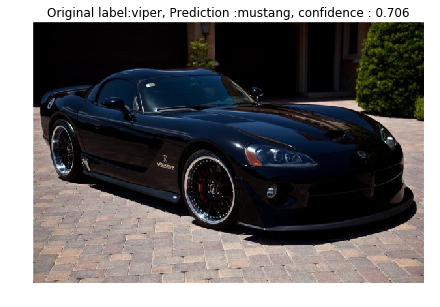

viper/viper_5.jpg


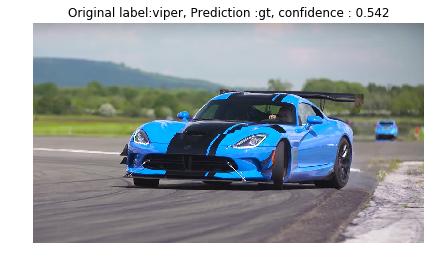

viper/viper_85.jpg


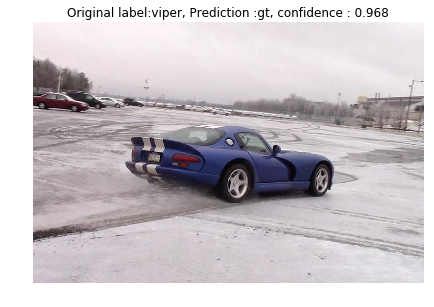

In [7]:
validation_datagen = ImageDataGenerator(rescale=1./255)

# Change the batchsize according to your system RAM
train_batchsize = 100
val_batchsize = 10
# Create a generator for prediction
validation_generator = validation_datagen.flow_from_directory(
        validation_dir,
        target_size=(image_size, image_size),
        batch_size=val_batchsize,
        class_mode='categorical',
        shuffle=False)

# Get the filenames from the generator
fnames = validation_generator.filenames

# Get the ground truth from generator
ground_truth = validation_generator.classes

# Get the label to class mapping from the generator
label2index = validation_generator.class_indices

# Getting the mapping from class index to class label
idx2label = dict((v,k) for k,v in label2index.items())

# Get the predictions from the model using the generator
predictions = model.predict_generator(validation_generator, steps=validation_generator.samples/validation_generator.batch_size,verbose=1)
predicted_classes = np.argmax(predictions,axis=1)

errors = np.where(predicted_classes != ground_truth)[0]
print("No of errors = {}/{}".format(len(errors),validation_generator.samples))

# Show the errors
for i in range(len(errors)):
    pred_class = np.argmax(predictions[errors[i]])
    pred_label = idx2label[pred_class]
    
    title = 'Original label:{}, Prediction :{}, confidence : {:.3f}'.format(
        fnames[errors[i]].split('/')[0],
        pred_label,
        predictions[errors[i]][pred_class])
    
    original = load_img('{}/{}'.format(validation_dir,fnames[errors[i]]))
    print(fnames[errors[i]])
    plt.figure(figsize=[7,7])
    plt.axis('off')
    plt.title(title)
    plt.imshow(original)
    plt.show()

Confusion matrix, without normalization
[[ 62   1   0   0   0   1   0   0   0   1   0   2   0   0   0   0   0]
 [ 11  55   0   0   0   0   0   0   2   2   0   0   0   1   0   0   0]
 [  3   0  58   2   0   2   0   0   0   1   0   0   0   1   1   0   0]
 [  3   0   0  72   0   0   0   0   2   2   0   2   0   0   0   2   0]
 [  3   0   0   0  51   0   2   3   1   0   0   1   0   0   9   1   0]
 [  2   0   2   0   0  49   0   0   0   2   0   0   0   0   0   0   0]
 [  1   1   0   0   1   0  50   5   0   0   0   0   0   0   2   0   0]
 [  1   0   1   1   0   0   1  36   0   0   0   1   1   1   5   0   0]
 [  2   0   1   0   0   1   0   1  62   1   0   2   1   1   2   0   0]
 [  0   1   0   0   0   0   0   0   0  51   0   0   0   0   0   1   0]
 [  1   1   0   0   0   1   0   1   0   6  48   1   1   0   2   1   0]
 [  3   1   0   1   0   0   0   0   0   1   0  66   0   0   0   0   1]
 [  6   2   0   0   0   0   0   0   0   0   1   0  57   0   0   0   1]
 [  5   0   1   0   1   1   0   1   0

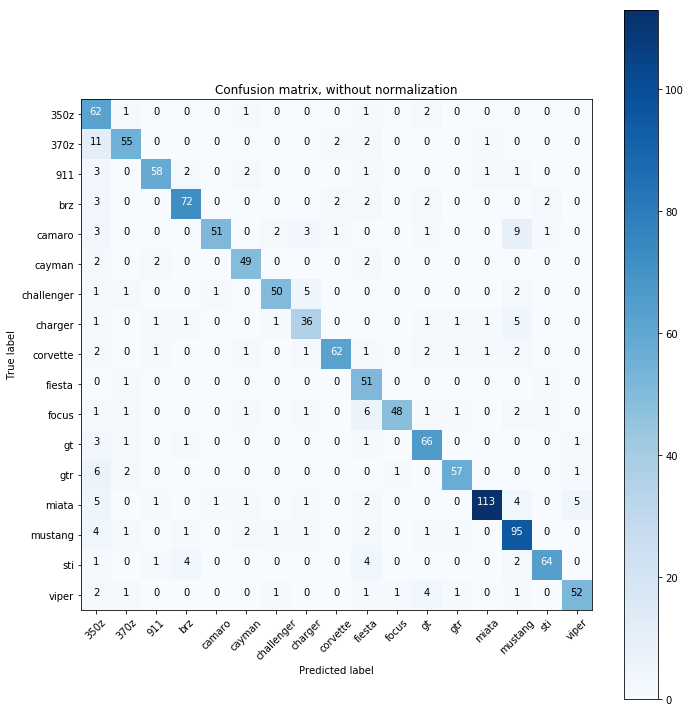

In [9]:
from sklearn.metrics import confusion_matrix
cm = confusion_matrix(ground_truth,predicted_classes)

labels = []
for k,v in idx2label.items():
    labels.append(v)
    
import itertools
def plot_confusion_matrix(cm, classes,
                          normalize=False,
                          title='Confusion matrix',
                          cmap=plt.cm.Blues):
    """
    This function prints and plots the confusion matrix.
    Normalization can be applied by setting `normalize=True`.
    """
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
        print("Normalized confusion matrix")
    else:
        print('Confusion matrix, without normalization')

    print(cm)

    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes, rotation=45)
    plt.yticks(tick_marks, classes)

    fmt = '.2f' if normalize else 'd'
    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        plt.text(j, i, format(cm[i, j], fmt),
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.tight_layout()
    plt.ylabel('True label')
    plt.xlabel('Predicted label')
    

plt.figure(figsize=(10,10))
plot_confusion_matrix(cm, classes=labels,
                      title='Confusion matrix, without normalization')